# Example planet injection in an IFS cube

> Author: *Valentin Christiaens*  
> Last update: *2022/04/05*

### Table of contents

* [1. Loading and visualizing the data](#1.-Loading-and-visualizing-the-data)

* [2. Planet parameters and spectra](#2.-Planet-parameters-and-spectra)

* [3. Flux normalization](#3.-Flux-normalization)

* [4. Injection](#4.-Injection)

* [5. Validation](#5.-Validation)

The purpose of this tutorial is to show the procedure followed for the injection of planets in the Exoplanet Data Challenge (phase 2).

-----------

Let's first import the packages needed in this tutorial:

In [1]:
from eidc2.injection import inject_fcp_ifs

import glob
from hciplot import plot_frames, plot_cubes
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

from special.model_resampling import resample_model
from special.utils_spec import find_nearest

from vip_hci.config import VLT_SPHERE_IFS
from vip_hci.fits import open_fits, write_fits
from vip_hci.fm import firstguess, normalize_psf
from vip_hci.metrics import snr
from vip_hci.psfsub import pca
from vip_hci.var import frame_center, dist

## 1. Loading and visualizing the data

In the 'dataset' folder of the `phase2` repository you can find a toy SPHERE/IFS coronagraphic cube acquired in pupil-stabilized mode on the source HIP39826 (a star with no reported directly imaged companion). The folder also contains the associated non-coronagraphic point spread function (PSF), wavelength vector and parallactic angles (the latter also including information on the airmass of the source). Let's first define the test set we will use:

In [2]:
test_set = 'sphere2'


Let's now load the data. Note that more info on opening and visualizing fits files with VIP in general is available [in the first VIP tutorial](https://vip.readthedocs.io/en/latest/tutorials/01_quickstart.html).

**REPLACE next box when Zenodo link is available**

In [3]:
path = '/Users/Valentin/Documents/Postdoc/EIDC/Cubes/data_test/'
datpath = path+'datasets/'

In [4]:
cubename = datpath+'image_cube_{}.fits'.format(test_set)
psfname = datpath+'psf_cube_{}.fits'.format(test_set)
lbdaname = datpath+'wavelength_vect_{}.fits'.format(test_set)
angname = datpath+'parallactic_angles_{}.fits'.format(test_set)

cube = open_fits(cubename)
psf = open_fits(psfname)
lbda = open_fits(lbdaname)
pa = open_fits(angname)

derot_angles = pa[0] # note: SPHERE DRH returns parallactic angles, while VIP routines take derotation angles as input - considering PA as input effectively considers opposite derotation angles
X_sci = pa[1]

nch, nz, ny, nx = cube.shape

Fits HDU-0 data successfully loaded. Data shape: (39, 65, 189, 189)
Fits HDU-0 data successfully loaded. Data shape: (39, 29, 29)
Fits HDU-0 data successfully loaded. Data shape: (39,)
Fits HDU-0 data successfully loaded. Data shape: (2, 65)


Each IFS spectral cube consists of 39 monochromatic images spread in wavelengths between the Y and J bands ('YJ' mode) or Y and H bands ('YJH' mode). Here the IFS+ADI cube contains 65 such spectral cubes combined into a single master cube. The first column of the parallactic angle file actually contains the parallactic (derotation) angles, while the second columns contains the airmass at which each spectral cube was obtained.

The **master spectral cube** is already centered. Let's inspect the first and last wavelengths, using `hciplot.plot_cubes` (feel free to set the backend to 'bokeh' to read pixel values interactively):

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[189, 189, 65]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
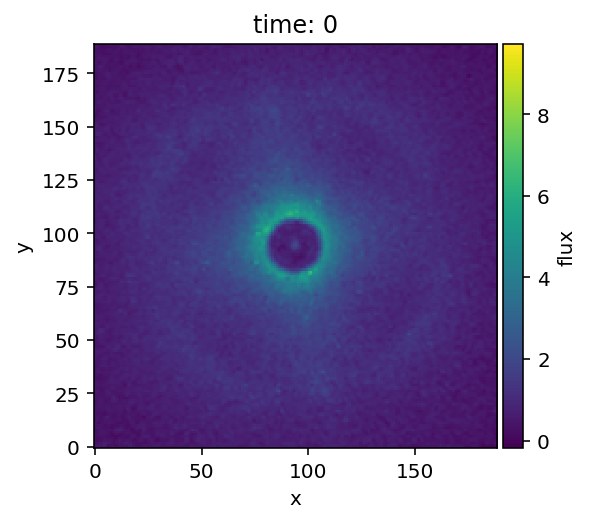

In [5]:
plot_cubes(cube[0])#, backend='bokeh')

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[189, 189, 65]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
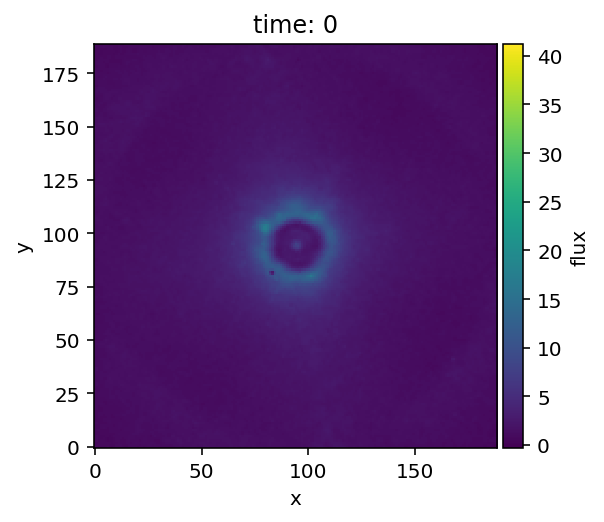

In [6]:
plot_cubes(cube[-1])

Now let's inspect the **PSF cube** (one frame per wavelength), which will be used for the actual injection of a fake planet:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[29, 29, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
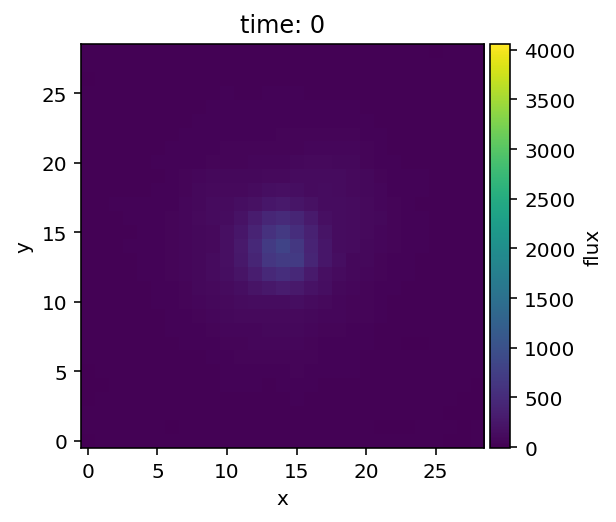

In [7]:
plot_cubes(psf)

As we can see, the flux varies as a function of wavelength. This reflects the intrinsic spectrum of the star but also the instrumental response and atmospheric absorption bands (e.g. associated to the water molecule) affecting some wavelengths more than others. The flux will be normalized in the next section, before injection.

Now let's check the **parallactic angle** and **airmass** variations:

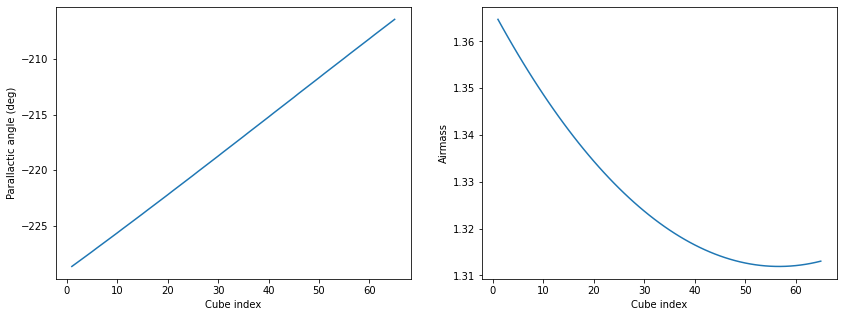

In [8]:
%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(range(1,nz+1), derot_angles)
ax1.set_xlabel("Cube index")
ax1.set_ylabel("Parallactic angle (deg)")
ax2.plot(range(1,nz+1), X_sci)
ax2.set_xlabel("Cube index")
ax2.set_ylabel("Airmass")
plt.show()

Let's define the **pixel scale** for IFS - note that this is optional since the planet coordinates will be given in pixels. It will still be useful to have meaningful radial separations expressed in arcsec.

In [9]:
plsc = VLT_SPHERE_IFS['plsc']
print(plsc, "arcsec/px")

0.0074 arcsec/px


Let's also define the spectral resolution of the instrument (which will be used for convolution of model spectra):

In [10]:
spec_res = 50.

Let's now load and visualize the coronagraphic radial **transmission** profile:

In [11]:
path = '../data/transmissions/'
trans = open_fits(path+"CoroTransmission_SPHERE-IFS_YJ-APLC.fits")

Fits HDU-0 data successfully loaded. Data shape: (40, 23)


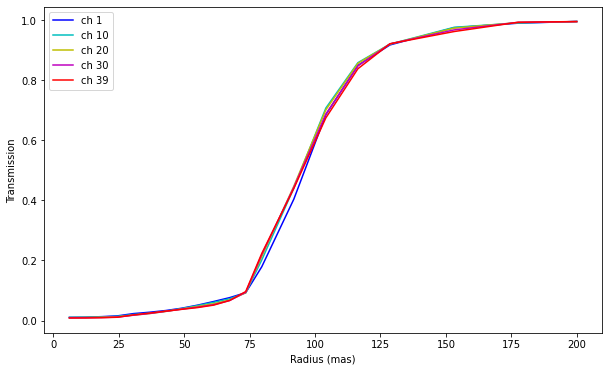

In [12]:
last_r = 20
plt.figure(figsize=(10,6))
plt.plot(trans[0,:last_r]*1000, trans[1,:last_r], 'b', label='ch 1')
plt.plot(trans[0,:last_r]*1000, trans[10,:last_r], 'c', label='ch 10')
plt.plot(trans[0,:last_r]*1000, trans[20,:last_r], 'y', label='ch 20')
plt.plot(trans[0,:last_r]*1000, trans[30,:last_r], 'm', label='ch 30')
plt.plot(trans[0,:last_r]*1000, trans[-1,:last_r], 'r', label='ch 39')
plt.xlabel("Radius (mas)")
plt.ylabel("Transmission")
plt.legend()

[Go to the top](#Table-of-contents)

## 2. Planet parameters and spectra

Now let's set the **ground truth coordinates** and average **contrast** (over all wavelengths) at which two planets will be injected in this cube:

In [13]:
xy_b = (98.6,73.7)
contrast_b = 1e-3

xy_c = (163.8,49.9)
contrast_c = 2e-4

Let's convert cartesian to polar coordinates:

In [14]:
cy, cx = frame_center(cube)
r_b = dist(cy, cx, xy_b[1], xy_b[0])
r_c = dist(cy, cx, xy_c[1], xy_c[0])

theta_b = np.rad2deg(np.arctan2(xy_b[1]-cy, xy_b[0]-cx))
theta_c = np.rad2deg(np.arctan2(xy_c[1]-cy, xy_c[0]-cx))

In [15]:
print(cy, cx)
print(r_b, theta_b)
print(r_c, theta_c)

94 94
20.814658296498642 -77.23233685531714
82.56421743103971 -32.28490848063569


Now let's load the two **model spectra** that we will use for injection. These were synthetized using petitRadtrans ([Molliere et al. 2019](https://ui.adsabs.harvard.edu/abs/2019A%26A...627A..67M/abstract)). We will consider a blackbody for planet b and the best-fit pRT model to the HR 8799e planet for planet c ([Molliere et al. 2020](https://ui.adsabs.harvard.edu/abs/2020A%26A...640A.131M/abstract))):

In [16]:
path = '../data/spectra/'
spec_b_name = path+'1800K_Blackbody.dat'
spec_c_name = path+'HR8799e_bestfit.dat'

df_b = pd.read_csv(spec_b_name, sep=" ", header=None, names=['lbda', 'flux'])
df_c = pd.read_csv(spec_c_name, sep=" ", header=None, names=['lbda', 'flux'])

In [17]:
lbda_b, fluxes_b = df_b['lbda'], df_b['flux']
lbda_c, fluxes_c = df_c['lbda'], df_c['flux']
n_wl = len(lbda_b)

The two spectra were loaded as `pandas` data frames. Let's visualize them:

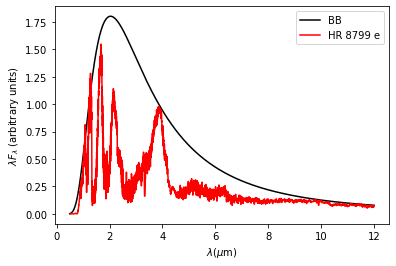

In [18]:
plt.plot(lbda_b, lbda_b*fluxes_b/np.amax(fluxes_b), 'k', label='BB')
plt.plot(lbda_c, lbda_c*fluxes_c/np.amax(fluxes_c), 'r', label='HR 8799 e')
plt.xlabel(r"$\lambda (\mu$m)")
plt.ylabel(r"$\lambda F_{\lambda}$ (arbitrary units)")
plt.legend()

Let's save wavelengths and fluxes as numpy arrays:

In [19]:
spec_b = np.array([lbda_b, fluxes_b])
spec_c = np.array([lbda_c, fluxes_c])

[Go to the top](#Table-of-contents)

## 3. Flux normalization

### 3.1. Non-coronagraphic PSF normalization

Let's measure the flux and FWHM of the non-coronagraphic PSF and normalize its flux to 1 in a 1-FWHM radius aperture (all at once), in all channels, using VIP's `fm/normalize_psf` function. We use the `debug` option to check that each 2D Gaussian fit worked properly:

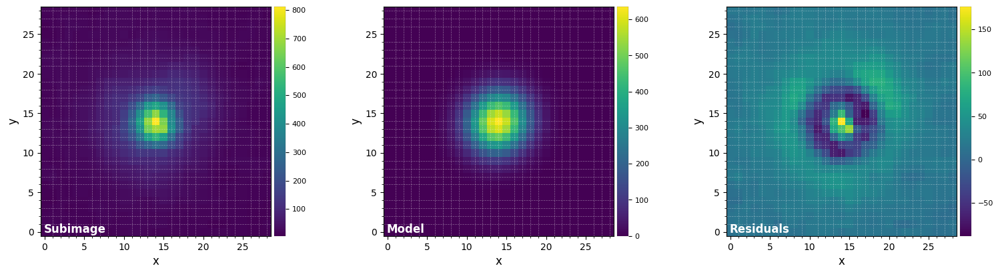

FWHM_y = 6.249918590625379
FWHM_x = 5.955174570821388 

centroid y = 13.912712804514848
centroid x = 13.89930852239608
centroid y subim = 13.912712804514848
centroid x subim = 13.89930852239608 

amplitude = 636.3209207145087
theta = -40.20327494950595


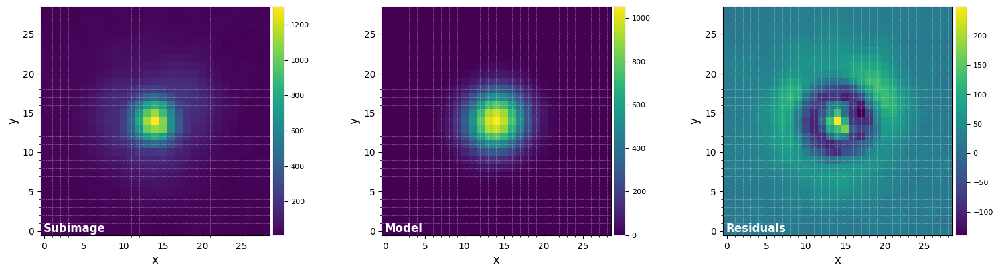

FWHM_y = 6.115031733427154
FWHM_x = 5.83909291219867 

centroid y = 14.027611189747015
centroid x = 13.902123414264723
centroid y subim = 14.027611189747015
centroid x subim = 13.902123414264723 

amplitude = 1054.2949916064315
theta = -37.536071255420595


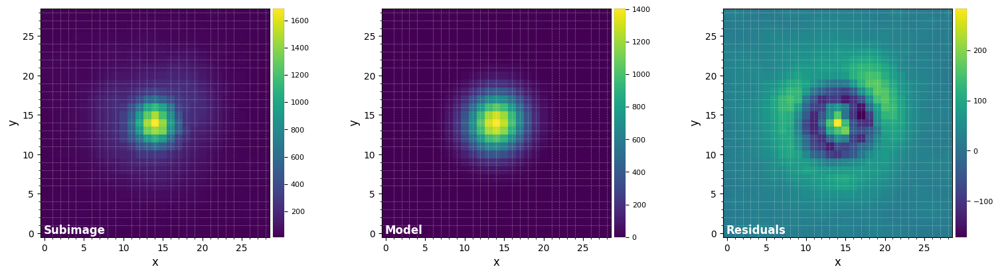

FWHM_y = 6.017536940978627
FWHM_x = 5.754055056927457 

centroid y = 14.064675014828953
centroid x = 13.92189940782825
centroid y subim = 14.064675014828953
centroid x subim = 13.92189940782825 

amplitude = 1404.7946951267922
theta = -32.753406960100804


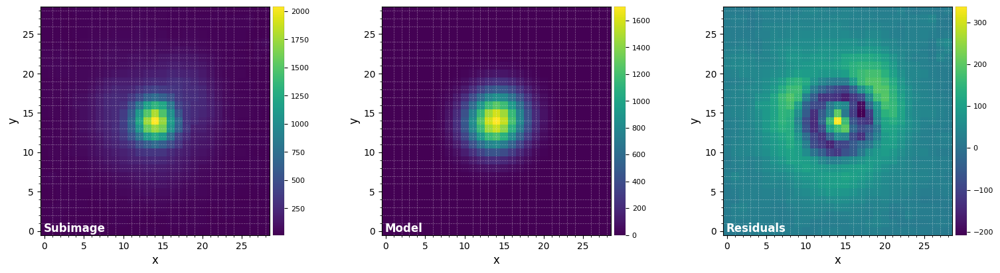

FWHM_y = 5.9918781552060665
FWHM_x = 5.682647009422151 

centroid y = 14.065184394206616
centroid x = 13.946038597175635
centroid y subim = 14.065184394206616
centroid x subim = 13.946038597175635 

amplitude = 1705.2716467832417
theta = -37.38382831177306


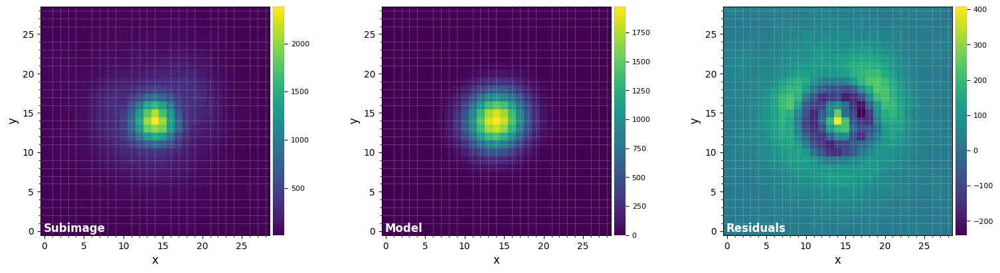

FWHM_y = 6.025210456837181
FWHM_x = 5.719302651407007 

centroid y = 14.075784813017359
centroid x = 13.955473078460217
centroid y subim = 14.075784813017359
centroid x subim = 13.955473078460217 

amplitude = 1975.512023782089
theta = -39.227168101522786


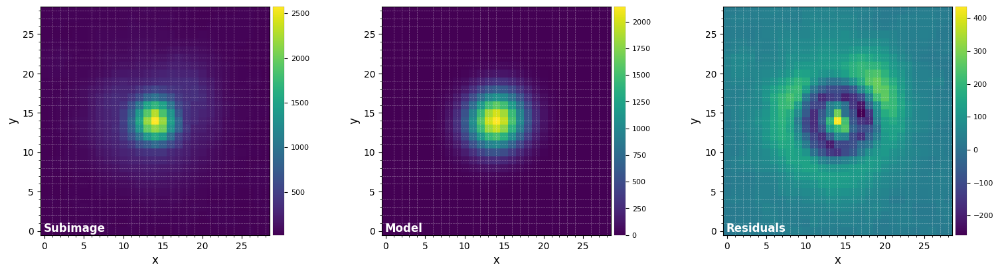

FWHM_y = 5.985037638840228
FWHM_x = 5.71990434228688 

centroid y = 14.090563585852108
centroid x = 13.954901979145388
centroid y subim = 14.090563585852108
centroid x subim = 13.954901979145388 

amplitude = 2143.996699880163
theta = -37.89243906945627


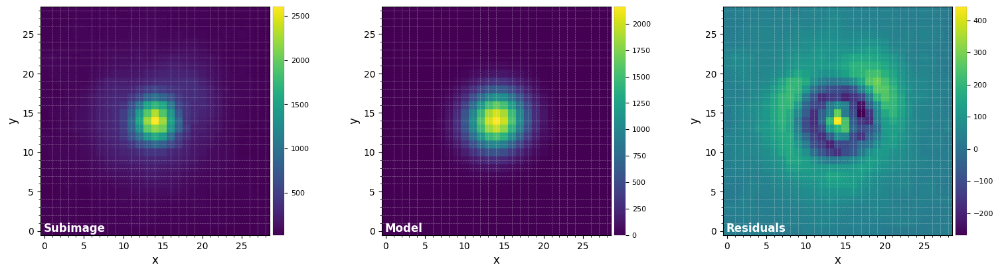

FWHM_y = 6.037449649434506
FWHM_x = 5.753733367061647 

centroid y = 14.109510955089752
centroid x = 13.980317492176528
centroid y subim = 14.109510955089752
centroid x subim = 13.980317492176528 

amplitude = 2165.8668020756913
theta = -38.98816537806606


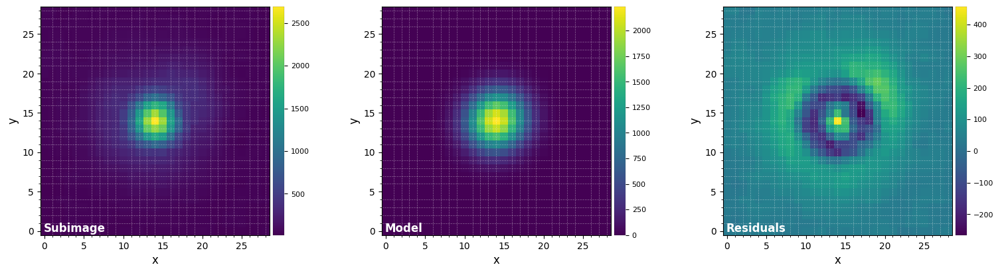

FWHM_y = 6.010425979658148
FWHM_x = 5.749988204487918 

centroid y = 14.091399025168501
centroid x = 13.986593684665712
centroid y subim = 14.091399025168501
centroid x subim = 13.986593684665712 

amplitude = 2237.4526741829254
theta = -42.08255560945647


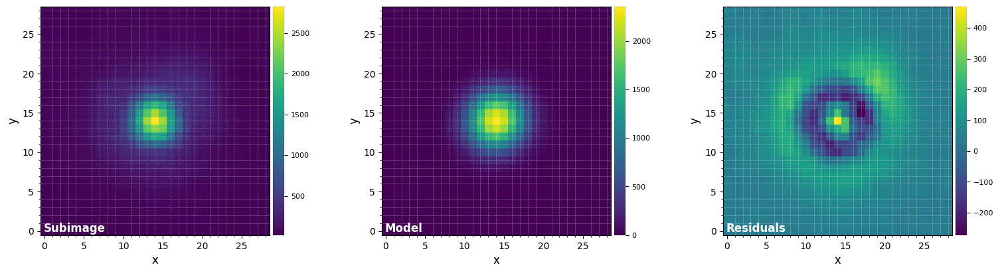

FWHM_y = 6.005151597186863
FWHM_x = 5.766189137359492 

centroid y = 14.090254937281157
centroid x = 14.000261828564378
centroid y subim = 14.090254937281157
centroid x subim = 14.000261828564378 

amplitude = 2355.1073353636825
theta = -38.12872688398152


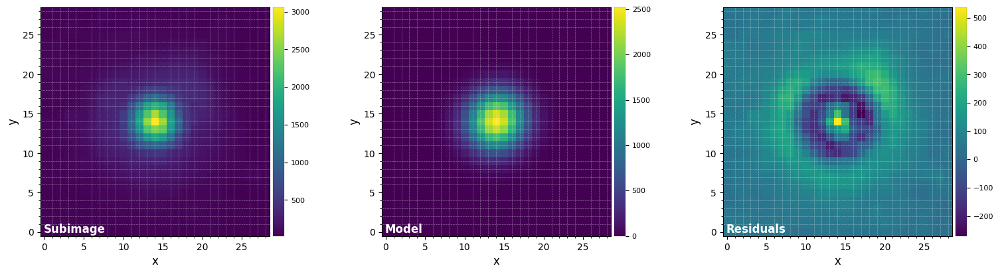

FWHM_y = 5.968097471112488
FWHM_x = 5.732989798766061 

centroid y = 14.102026780112409
centroid x = 14.00192256597961
centroid y subim = 14.102026780112409
centroid x subim = 14.00192256597961 

amplitude = 2523.955221661578
theta = -36.16671879464335


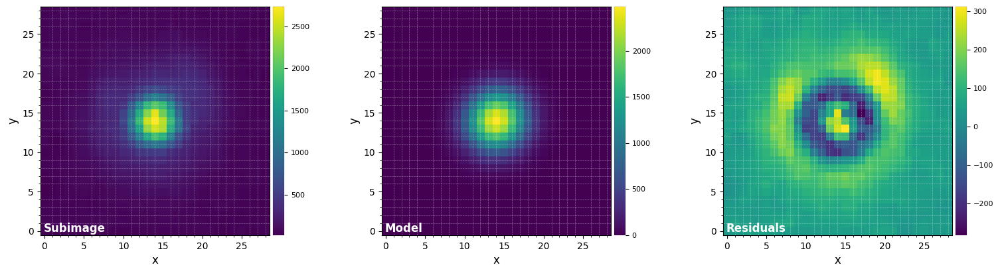

FWHM_y = 6.201045253062894
FWHM_x = 5.952529125946643 

centroid y = 14.09561886484433
centroid x = 14.011238141279097
centroid y subim = 14.09561886484433
centroid x subim = 14.011238141279097 

amplitude = 2483.278573207968
theta = -40.01453306537682


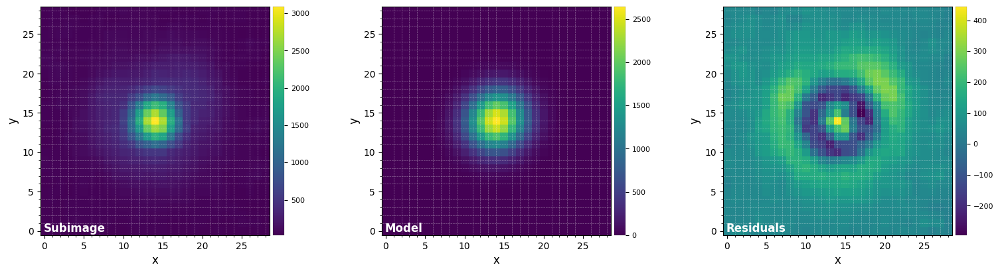

FWHM_y = 6.1167439995646244
FWHM_x = 5.839271620946151 

centroid y = 14.100847253490924
centroid x = 14.00962801008153
centroid y subim = 14.100847253490924
centroid x subim = 14.00962801008153 

amplitude = 2649.287384069412
theta = -42.97211525180409


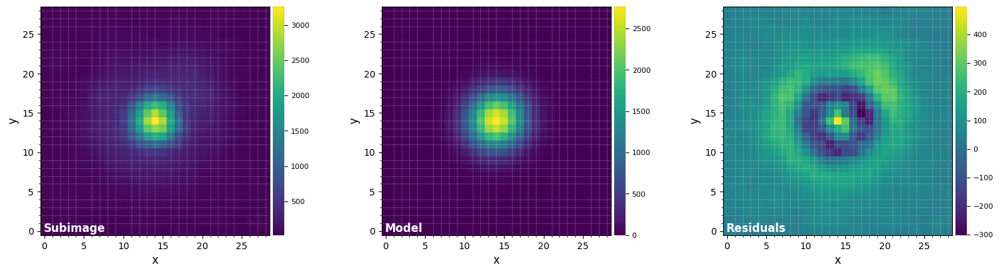

FWHM_y = 6.037056836628313
FWHM_x = 5.786392745942098 

centroid y = 14.110142788418317
centroid x = 14.004784235107909
centroid y subim = 14.110142788418317
centroid x subim = 14.004784235107909 

amplitude = 2770.0240286010007
theta = -39.87700223659835


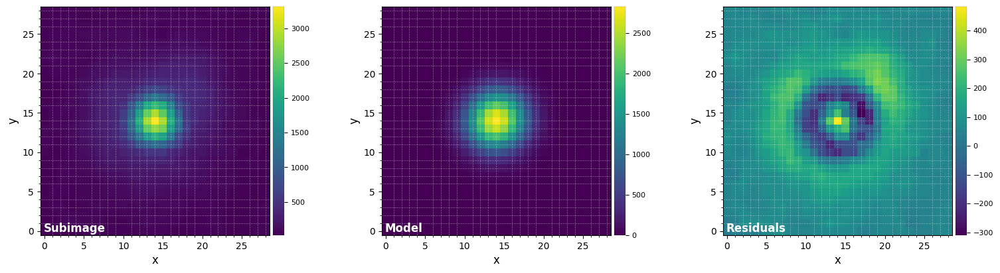

FWHM_y = 6.066318705156946
FWHM_x = 5.822724547170392 

centroid y = 14.099317823625379
centroid x = 14.003150239110157
centroid y subim = 14.099317823625379
centroid x subim = 14.003150239110157 

amplitude = 2830.2548554359573
theta = -47.81201829549842


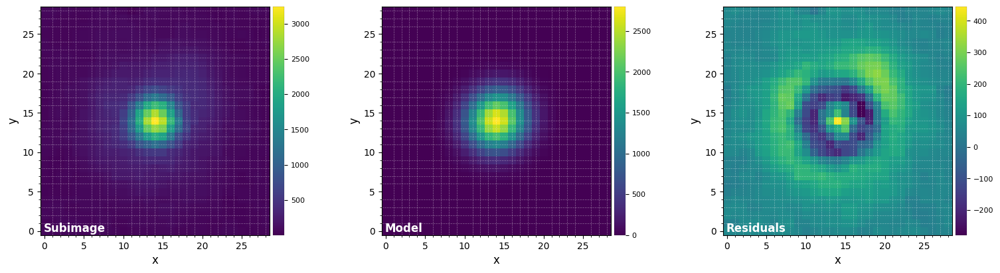

FWHM_y = 6.076253484626576
FWHM_x = 5.8064868728535695 

centroid y = 14.112521461380666
centroid x = 14.034377198493269
centroid y subim = 14.112521461380666
centroid x subim = 14.034377198493269 

amplitude = 2803.405353990872
theta = -1130.8992713589835


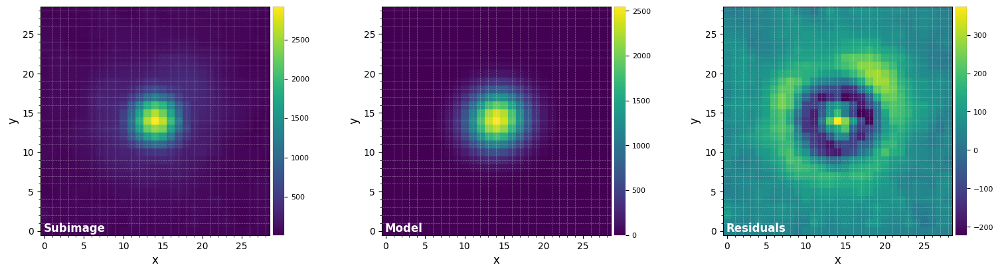

FWHM_y = 5.78340826410417
FWHM_x = 6.094768878919073 

centroid y = 14.151451481603505
centroid x = 14.04623588538711
centroid y subim = 14.151451481603505
centroid x subim = 14.04623588538711 

amplitude = 2553.3202960394237
theta = -1046.1876651647306


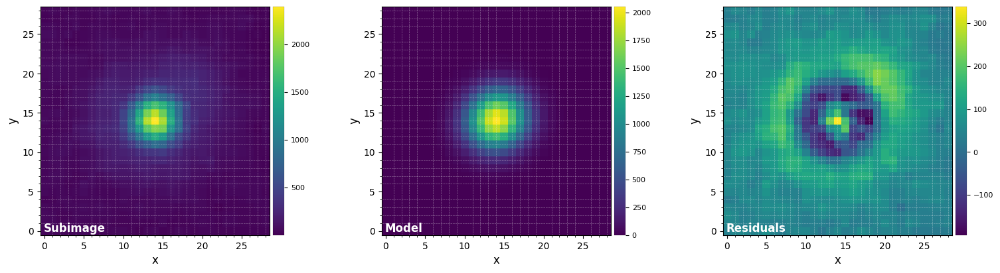

FWHM_y = 6.181608395179831
FWHM_x = 5.8193909503216625 

centroid y = 14.206064453326714
centroid x = 14.027564826853363
centroid y subim = 14.206064453326714
centroid x subim = 14.027564826853363 

amplitude = 2063.1990503463253
theta = -591.8971102346304


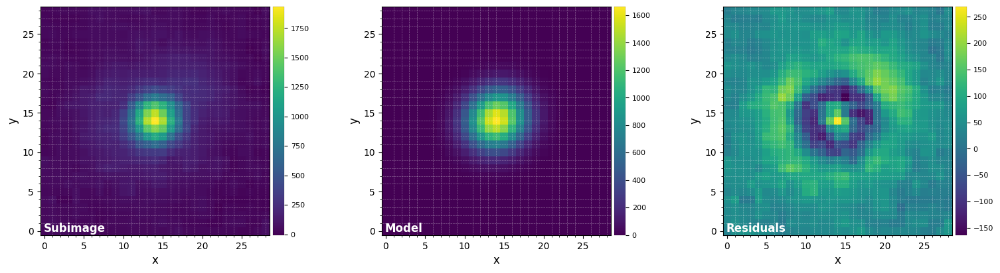

FWHM_y = 5.751799173200897
FWHM_x = 6.1765747725042495 

centroid y = 14.199498957513265
centroid x = 14.014692732639789
centroid y subim = 14.199498957513265
centroid x subim = 14.014692732639789 

amplitude = 1668.5839475163139
theta = 214.19574599466478


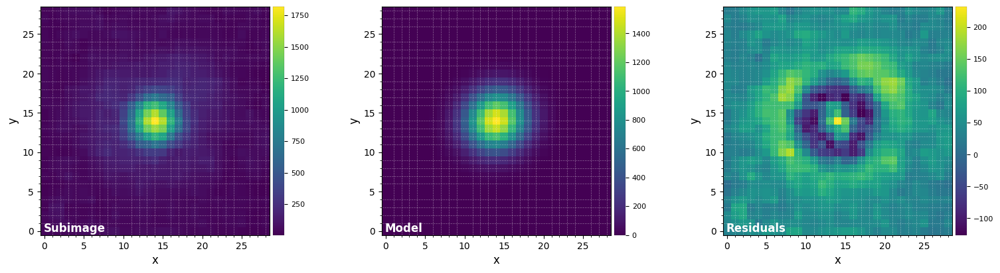

FWHM_y = 5.797247572765799
FWHM_x = 6.140720682799337 

centroid y = 14.09188009913005
centroid x = 13.97827848457926
centroid y subim = 14.09188009913005
centroid x subim = 13.97827848457926 

amplitude = 1587.9799969490432
theta = 208.9336267041074


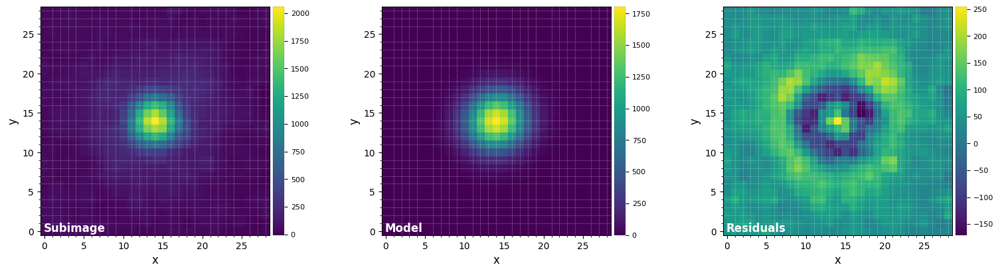

FWHM_y = 6.1732867167382
FWHM_x = 5.8497702682633586 

centroid y = 14.020275158168136
centroid x = 14.00256734343732
centroid y subim = 14.020275158168136
centroid x subim = 14.00256734343732 

amplitude = 1805.5945893071935
theta = 117.55114923044374


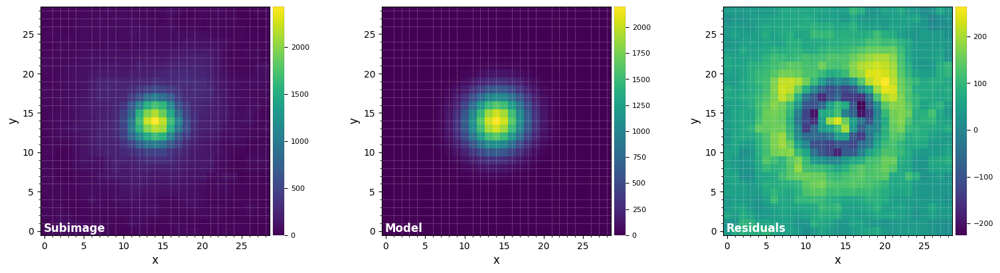

FWHM_y = 5.879233953058072
FWHM_x = 6.127221747592718 

centroid y = 13.989753883923711
centroid x = 14.002807252670436
centroid y subim = 13.989753883923711
centroid x subim = 14.002807252670436 

amplitude = 2198.1572616046824
theta = -320.21556686945866


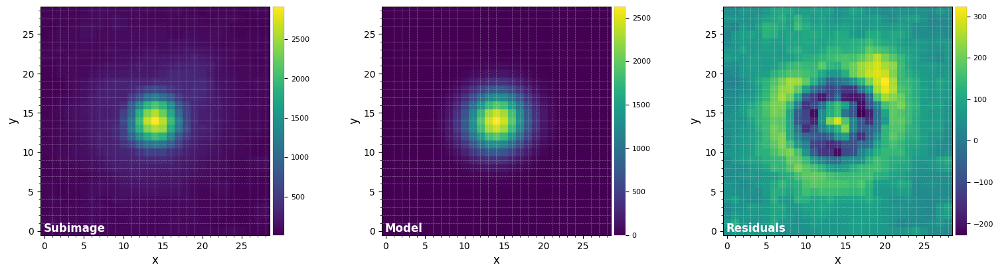

FWHM_y = 5.887171925622423
FWHM_x = 6.160164902722713 

centroid y = 14.006124941703272
centroid x = 14.009936779665049
centroid y subim = 14.006124941703272
centroid x subim = 14.009936779665049 

amplitude = 2628.4500069112014
theta = -321.3590169947588


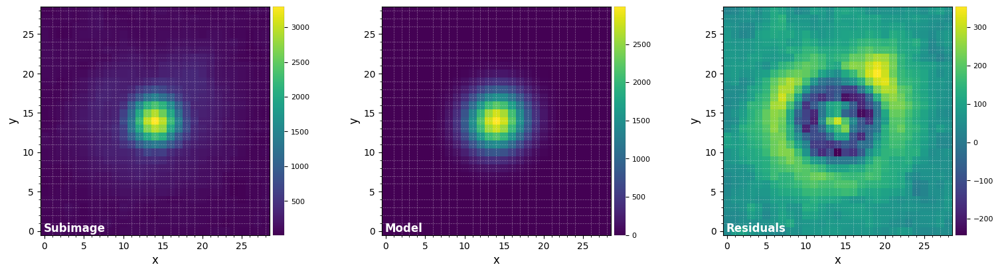

FWHM_y = 6.0983193806752976
FWHM_x = 5.823811537198284 

centroid y = 14.04578078126952
centroid x = 14.01477101186026
centroid y subim = 14.04578078126952
centroid x subim = 14.01477101186026 

amplitude = 2992.2717104226613
theta = -228.95610743164002


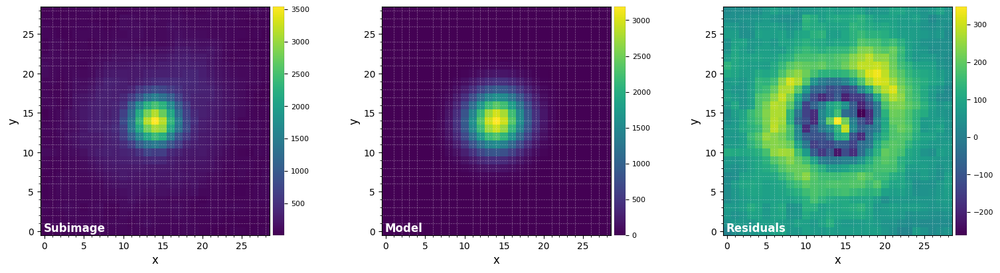

FWHM_y = 6.088143522859679
FWHM_x = 5.8003209490757035 

centroid y = 14.051247831826354
centroid x = 13.998093842074548
centroid y subim = 14.051247831826354
centroid x subim = 13.998093842074548 

amplitude = 3191.2868184142203
theta = -409.93971951101645


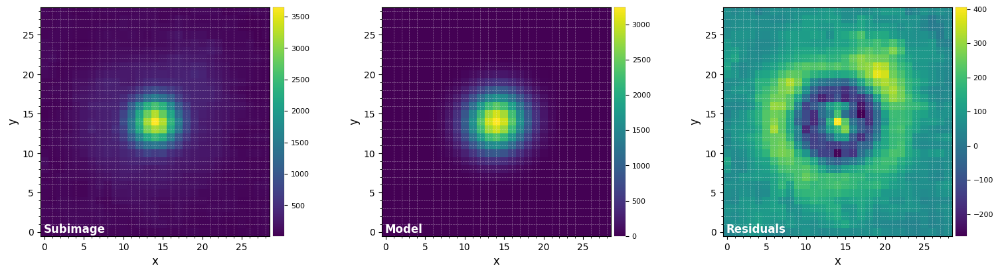

FWHM_y = 6.131166433296467
FWHM_x = 5.872212732534487 

centroid y = 14.035337815431665
centroid x = 13.998171477359165
centroid y subim = 14.035337815431665
centroid x subim = 13.998171477359165 

amplitude = 3243.165884766142
theta = -50.09403204938458


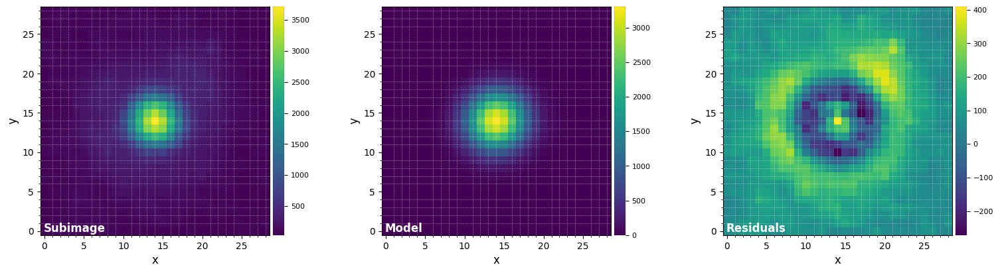

FWHM_y = 6.1749426650386505
FWHM_x = 5.9932124659024835 

centroid y = 14.039753518526705
centroid x = 13.991921001229356
centroid y subim = 14.039753518526705
centroid x subim = 13.991921001229356 

amplitude = 3307.8703264494
theta = -60.778524959138785


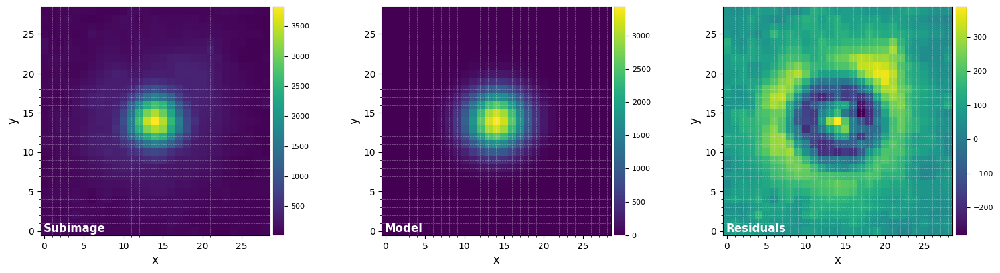

FWHM_y = 6.212946735034473
FWHM_x = 6.032862556063642 

centroid y = 14.009742406995104
centroid x = 13.967991908973474
centroid y subim = 14.009742406995104
centroid x subim = 13.967991908973474 

amplitude = 3436.0292600146126
theta = -233.074343782064


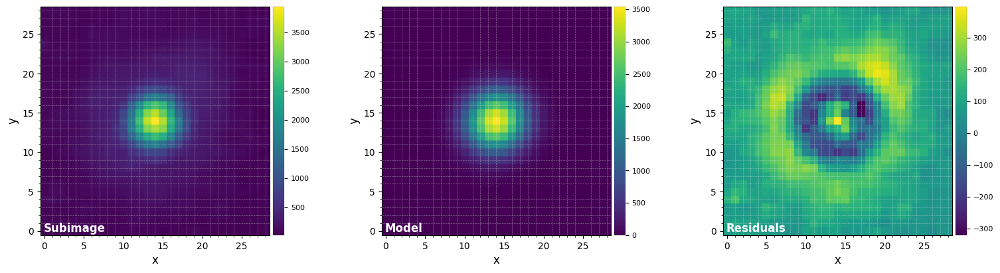

FWHM_y = 6.202834709617493
FWHM_x = 5.991454580377878 

centroid y = 14.020014512640392
centroid x = 13.952064722414017
centroid y subim = 14.020014512640392
centroid x subim = 13.952064722414017 

amplitude = 3546.656042036664
theta = -45.08873953984778


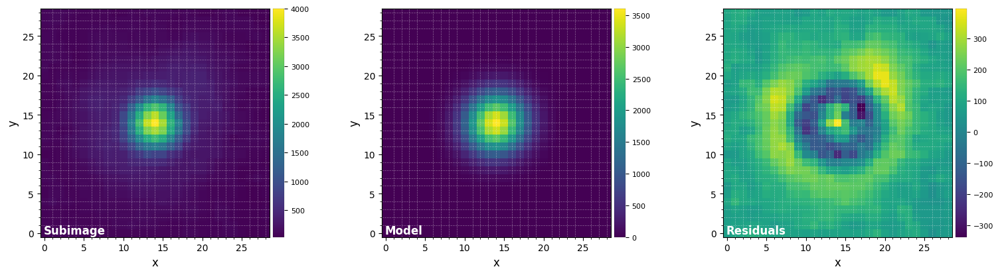

FWHM_y = 6.188582125733534
FWHM_x = 5.985402654635661 

centroid y = 14.012885928141898
centroid x = 13.933314914222644
centroid y subim = 14.012885928141898
centroid x subim = 13.933314914222644 

amplitude = 3607.1363107553057
theta = -45.542552785379904


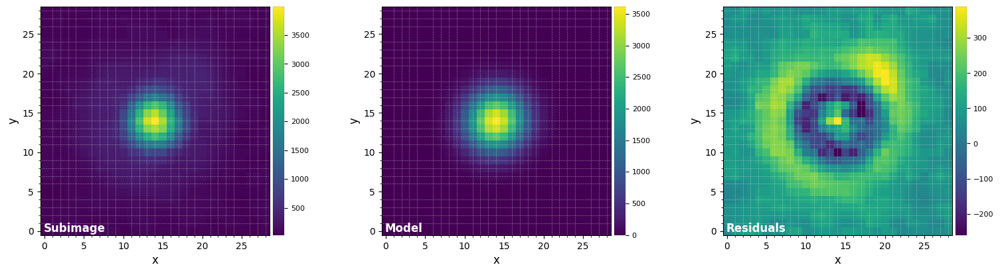

FWHM_y = 6.244755229551024
FWHM_x = 6.022172272876057 

centroid y = 14.00590897381181
centroid x = 13.928682611420799
centroid y subim = 14.00590897381181
centroid x subim = 13.928682611420799 

amplitude = 3616.1909624995233
theta = -32.925763043167755


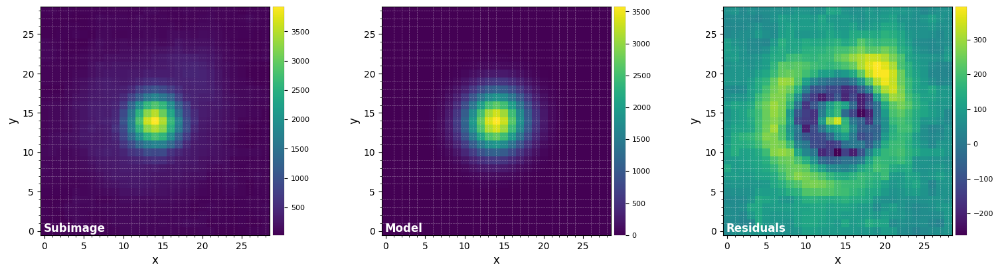

FWHM_y = 6.27304172170033
FWHM_x = 6.080609549792838 

centroid y = 13.982299985250767
centroid x = 13.934886096629457
centroid y subim = 13.982299985250767
centroid x subim = 13.934886096629457 

amplitude = 3579.548593229253
theta = -38.810946878862445


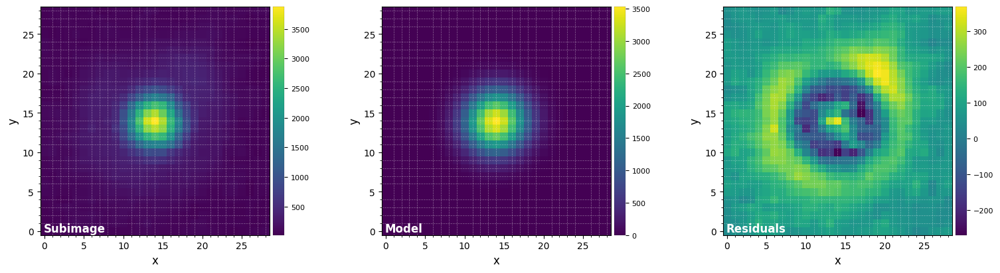

FWHM_y = 6.272897562677739
FWHM_x = 6.150604077395562 

centroid y = 13.949986869106837
centroid x = 13.940065010214068
centroid y subim = 13.949986869106837
centroid x subim = 13.940065010214068 

amplitude = 3535.36267540835
theta = -1487.052254957365


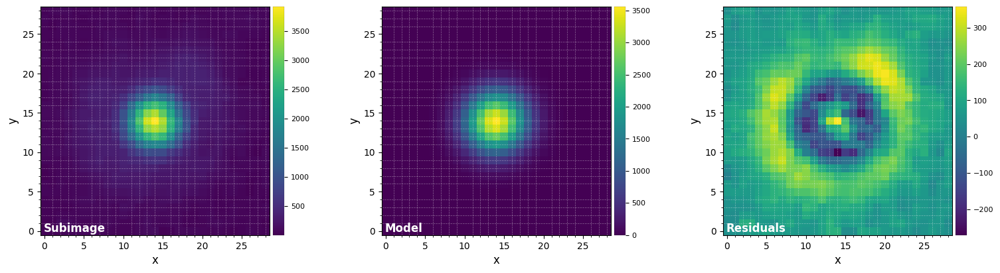

FWHM_y = 6.169653547163166
FWHM_x = 6.268150600253964 

centroid y = 13.931026676902302
centroid x = 13.920174694388791
centroid y subim = 13.931026676902302
centroid x subim = 13.920174694388791 

amplitude = 3562.252494864886
theta = 32.842817255455444


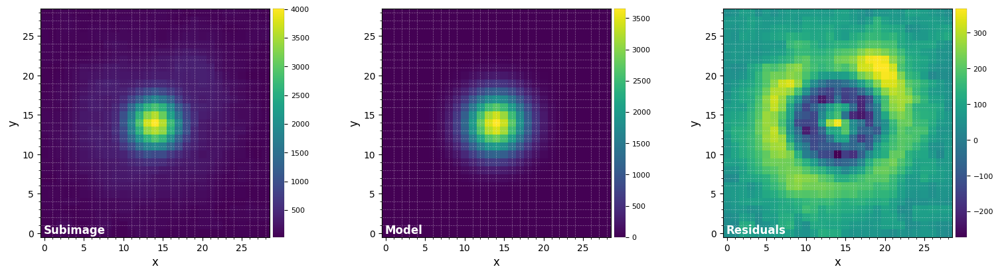

FWHM_y = 6.274537554500622
FWHM_x = 6.157837787311417 

centroid y = 13.934250084708902
centroid x = 13.92169790717976
centroid y subim = 13.934250084708902
centroid x subim = 13.92169790717976 

amplitude = 3655.664070910777
theta = 129.0032036755185


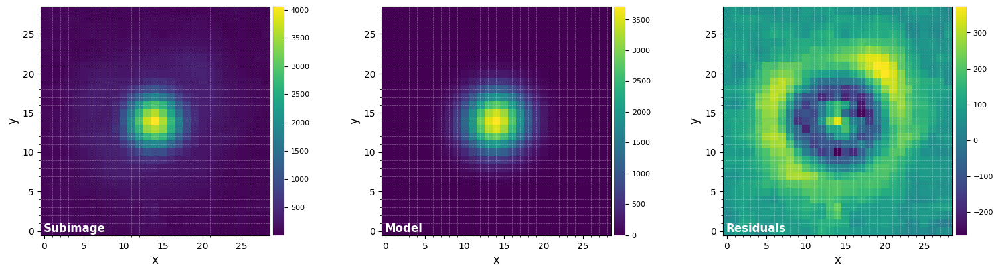

FWHM_y = 6.311436197874585
FWHM_x = 6.135315847492893 

centroid y = 13.945184682040301
centroid x = 13.90455843917349
centroid y subim = 13.945184682040301
centroid x subim = 13.90455843917349 

amplitude = 3713.222558796391
theta = -41.34373753210502


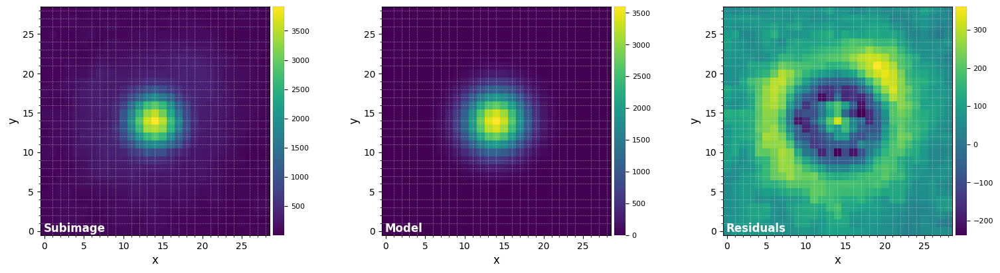

FWHM_y = 6.330588326155178
FWHM_x = 6.183593806815872 

centroid y = 13.97269314976903
centroid x = 13.886442080617911
centroid y subim = 13.97269314976903
centroid x subim = 13.886442080617911 

amplitude = 3603.9831790818416
theta = -39.62090236411358


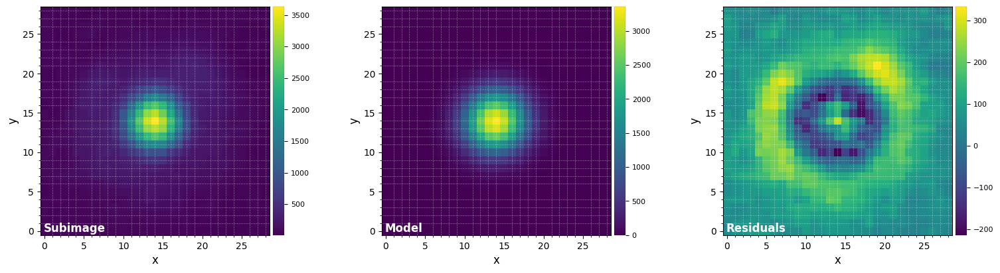

FWHM_y = 6.184001484216053
FWHM_x = 6.343494966712782 

centroid y = 13.949799220444797
centroid x = 13.882979812466415
centroid y subim = 13.949799220444797
centroid x subim = 13.882979812466415 

amplitude = 3362.492517413177
theta = -131.56408968416724


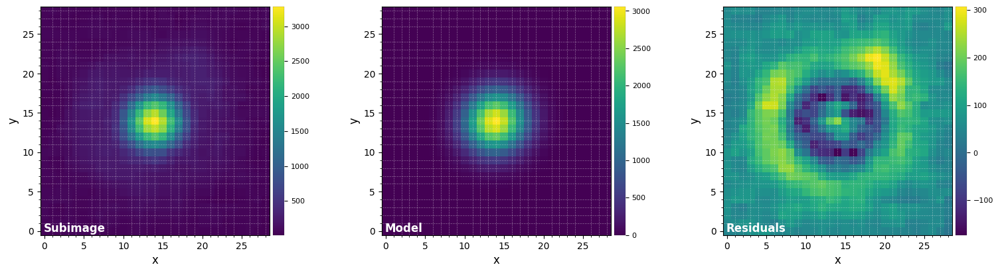

FWHM_y = 6.104938340342794
FWHM_x = 6.326105574311393 

centroid y = 13.963528380019108
centroid x = 13.869285619906863
centroid y subim = 13.963528380019108
centroid x subim = 13.869285619906863 

amplitude = 3062.496165602359
theta = -498.25201487357776


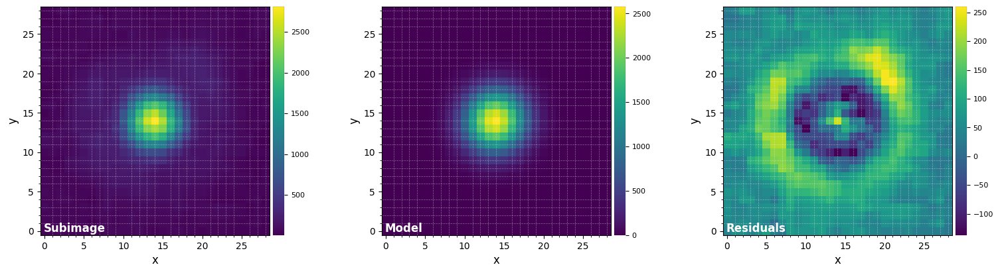

FWHM_y = 6.281872522029886
FWHM_x = 6.106896271562541 

centroid y = 14.035165570902214
centroid x = 13.854666632379166
centroid y subim = 14.035165570902214
centroid x subim = 13.854666632379166 

amplitude = 2583.840814837761
theta = -35.5994403427372
Mean FWHM per channel: 
[6.103 5.977 5.886 5.837 5.872 5.852 5.896 5.88  5.886 5.851 6.077 5.978
 5.912 5.945 5.941 5.939 6.    5.964 5.969 6.012 6.003 6.024 5.961 5.944
 6.002 6.084 6.123 6.097 6.087 6.133 6.177 6.212 6.219 6.216 6.223 6.257
 6.264 6.216 6.194]
Flux in 1xFWHM aperture: 
[13397.649 21373.517 27661.433 33057.763 38754.981 41781.661 42805.645
 44021.68  46395.703 49082.614 52371.307 53918.696 55093.806 56930.742
 56350.541 51298.303 42189.297 33733.489 32181.659 37142.073 45223.932
 54394.967 60556.863 64201.073 66477.378 69675.456 73203.718 74978.343
 76002.683 77311.678 77583.749 77448.17  78182.432 80187.787 81616.948
 80114.272 74899.504 67091.76  56185.008]


In [20]:
%matplotlib inline

psfn, flux_st, fwhm = normalize_psf(psf, fwhm='fit', full_output=True, debug=True)

Now let's plot the measured FWHM and stellar flux:

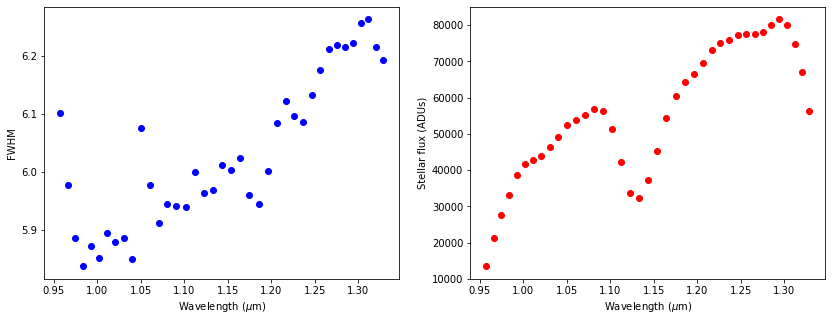

In [21]:
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, fwhm, 'bo')
ax1.set_xlabel(r"Wavelength ($\mu$m)")
ax1.set_ylabel("FWHM")
ax2.plot(lbda, flux_st, 'ro')
ax2.set_xlabel(r"Wavelength ($\mu$m)")
ax2.set_ylabel("Stellar flux (ADUs)")
plt.show()

**Fig. 3.1**: Measured FWHM and stellar flux in the non-coronagraphic PSF cube.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[29, 29, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
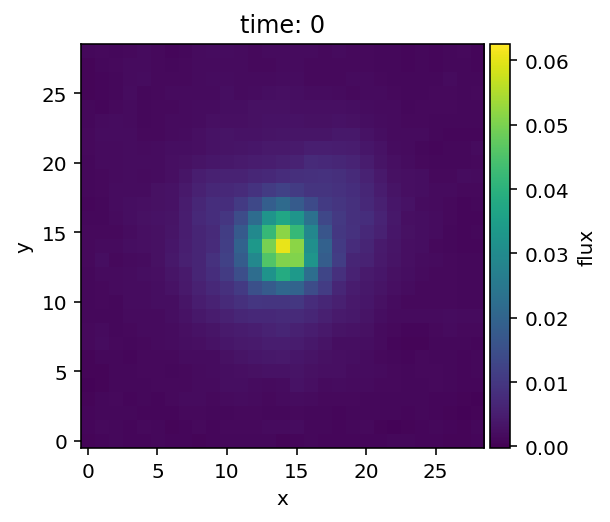

In [22]:
plot_cubes(psfn, grid=True)

Now let's save the measured spectrum of the star in the format we will need for the injection function:

In [23]:
spec_star = np.array([lbda, flux_st])

### 3.2. Stellar SED model

As can be seen in Fig. 3.1, the measured spectrum of the star is affected by both instrumental and atmospheric transmission. To know how to inject our planet spectra, we have to take that transmission into account.

We use NextGen SED models for the star observed in the different IFU datasets of the challenge. FYI, below is a table with the spectral type, assumed effective temperature and surface gravity for each star:

| Dataset |  Sp. Type |  T_eff |  log(g) |
| --- | --- | --- | --- |
| SPHERE-1 | B9V | 11,400 K | 4.5 |
| SPHERE-2 | K7V | 4,000 K | 4.5 |
| SPHERE-3 | M0V | 3,750 K | 4.5 |
| SPHERE-4 | A3V | 8,750 K | 4.5 |
| SPHERE-5 | A0V | 9,600 K | 4.5 |
| GPI-1 | A3V | 8,750 K | 4.5 |
| GPI-2 | A0V | 9,600 K | 4.5 |
| GPI-3 | F2V | 7,050 K | 4.5 |
| GPI-4 | G5V | 5,660 K | 4.5 |
| GPI-5 | K2V | 4,960 K | 4.5 |

For this test dataset, we consider a K7V SED model for the star:

In [24]:
path = "../data/spectra/"

sed_file = glob.glob(path+"stellarSED-{}*npy".format(test_set))[0]
print("The SED model for the star that will be considered is: {}".format(sed_file))

The SED model for the star that will be considered is: ../data/spectra/stellarSED-sphere2-k7v.npy


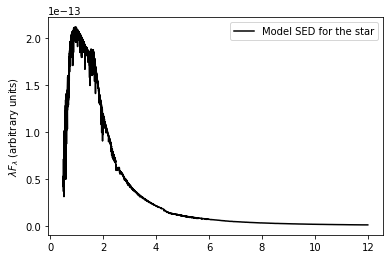

In [25]:
spec_star_mod = np.load(sed_file)

plt.plot(spec_star_mod[0], spec_star_mod[0]*spec_star_mod[1], 'k', label='Model SED for the star')
plt.ylabel(r"$\lambda F_{\lambda}$ (arbitrary units)")
plt.legend()

### 3.3. Airmass

Airmass variation is also taken into consideration for the injection of the planet spectra (more specifically we consider the ratio between individual airmass values and the median airmass over the observation):

In [26]:
med_X = np.median(X_sci)
X_fac = np.exp(-(X_sci-med_X))

Let's plot the factors to be applied to correct for airmass (w.r.t median airmass):

Text(0, 0.5, 'X factor')

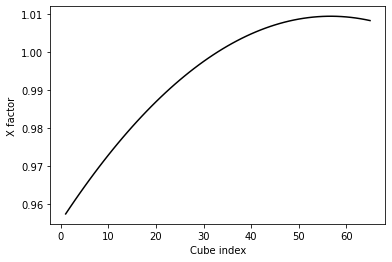

In [27]:
%matplotlib inline
plt.plot(range(1,nz+1), X_fac, 'k')
plt.xlabel("Cube index")
plt.ylabel("X factor")

[Go to the top](#Table-of-contents)

## 4. Injection

The injection function in the `eidc2` package combines both model resampling (using the `special` [package](https://special.readthedocs.io)) and fake planet injection in 4D (spectral+ADI) cubes (handled by the relevant function in the `VIP` [package](https://vip.readthedocs.io)). The planet spectrum is first convolved using the spectral FWHM - inferred from the mean spectral resolution of the instrument (provided by the `spec_res` parameter), and then resampled to match the IFS wavelength sampling. This is also done with the stellar model SED, before taking the ratio with the measured stellar flux - in order to estimate the atmospheric+instrumental transmission applied to the planet spectrum.

Let's now inject the 2 fake companions consecutively:

In [28]:
cube_fc1, gt_fluxes1 = inject_fcp_ifs(cube, derot_angles, psfn, rtheta_planet=(r_b, theta_b), 
                                      planet_spec=spec_b, star_obs_spec=spec_star, 
                                      star_mod_spec=spec_star_mod, mean_contrast=contrast_b, 
                                      norm_fac=X_fac, spec_res=spec_res, transmission=trans, 
                                      verbose=True, full_output=True)

cube_fc2, gt_fluxes2 = inject_fcp_ifs(cube_fc1, derot_angles, psfn, rtheta_planet=(r_c, theta_c), 
                                      planet_spec=spec_c, star_obs_spec=spec_star, 
                                      star_mod_spec=spec_star_mod, mean_contrast=contrast_c, 
                                      norm_fac=X_fac, spec_res=spec_res, transmission=trans, 
                                      verbose=True, full_output=True)

Flux levels used for planet injection (before considering airmass):  [  6.18315119  10.33157287  13.87168115  17.11292948  20.83451768
  23.34340703  24.79032894  26.49259274  29.05647169  31.87580505
  35.22125071  37.58020813  39.84549263  42.67767595  43.63983489
  41.00688959  34.8741177   28.90787683  28.53451867  33.95013609
  42.53775496  52.76632292  60.70524794  66.44685869  70.6608054
  75.60638852  80.79120748  84.36629862  87.51799271  91.15728787
  93.58790922  95.54614598  98.67798593 103.46465399 107.47262879
 107.74515581 102.86443306  93.57998551  79.25275698]
*** Processing spectral channel 1/39 ***
Branch 1:
	(X,Y)=(98.60, 73.70) at 20.81 arcsec (20.81 pxs from center)
*** Processing spectral channel 2/39 ***
*** Processing spectral channel 3/39 ***
*** Processing spectral channel 4/39 ***
*** Processing spectral channel 5/39 ***
*** Processing spectral channel 6/39 ***
*** Processing spectral channel 7/39 ***
*** Processing spectral channel 8/39 ***
*** Processing s

[Go to the top](#Table-of-contents)

## 5. Validation

### 5.1. PCA-ASDI

Let's double-check the companions were correctly injected, by post-processing the cube with the 2 injections using PCA-ASDI:

In [29]:
ncomp = 10
pca_fr = pca(cube_fc2, derot_angles, scale_list=lbda[-1]/lbda, ncomp=ncomp, crop_ifs=False)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2022-04-12 16:46:48
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 0.987 GB
Rescaling the spectral channels to align the speckles
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:29
Running time:  0:00:30.835941
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
2535 total frames
Performing single-pass PCA
Done vectorizing the frames. Matrix shape: (2535, 69169)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:02:16.338737
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Descaling the spectral channels
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:25
De-rotating and combining residuals
Running time:  0:02:41.381926
―――――――――――――――――――――――――――――――――――――――――――――――――――

Let's visualize the resulting image, including circles at the ground truth locations of the injected planets:

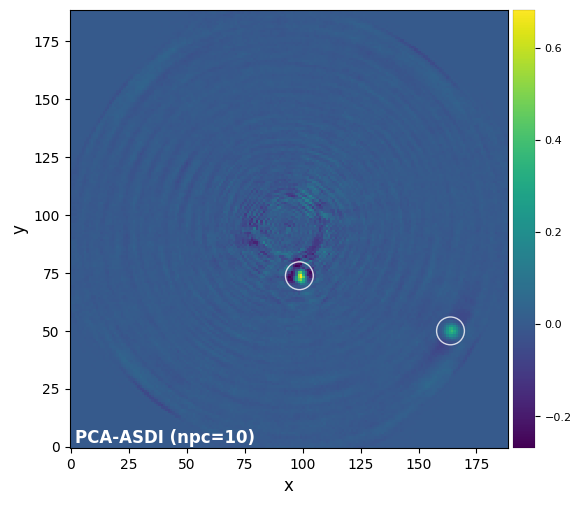

In [30]:
plot_frames(pca_fr, label='PCA-ASDI (npc={:.0f})'.format(ncomp),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

In [31]:
snr_b = snr(pca_fr, xy_b, fwhm=np.mean(fwhm))
snr_c = snr(pca_fr, xy_c, fwhm=np.mean(fwhm))
print(snr_b, snr_c)

10.77589012322391 25.879071698660542


### 5.2. Recovered spectrum with NEGFC

Let's use the negative fake companion technique (combined with PCA-ADI) to estimate the flux of the companion in each spectral channel. For this quick validation, we just use the `firstguess` function in VIP which finds a first estimate on a grid of flux values followed by a simplex:

In [32]:
est_fluxes1 = np.zeros(nch)
for i in range(nch):
    trans_i = np.array([trans[0],trans[i]])
    res = firstguess(cube_fc2[i], derot_angles, psfn[i], ncomp=4, plsc=plsc, planets_xy_coord=[xy_b], 
                     fwhm=fwhm[i], annulus_width=int(2*fwhm[i]), aperture_radius=1, imlib='opencv',
                     f_range=None, transmission=trans_i, mu_sigma=True, force_rPA=True,
                     simplex=True, plot=False, verbose=False)
    _, _, est_fluxes1[i] = res

In [33]:
est_fluxes2 = np.zeros(nch)
for i in range(nch):
    trans_i = np.array([trans[0],trans[i]])
    res = firstguess(cube_fc2[i], derot_angles, psfn[i], ncomp=2, plsc=plsc, planets_xy_coord=[xy_c], 
                     fwhm=fwhm[i], annulus_width=int(2*fwhm[i]), aperture_radius=1, imlib='opencv',
                     f_range=None, transmission=trans_i, mu_sigma=True, force_rPA=True,
                     simplex=True, plot=False, verbose=False)
    _, _, est_fluxes2[i] = res

Let's now compare the retrieved fluxes to the ground truth values used for injection:

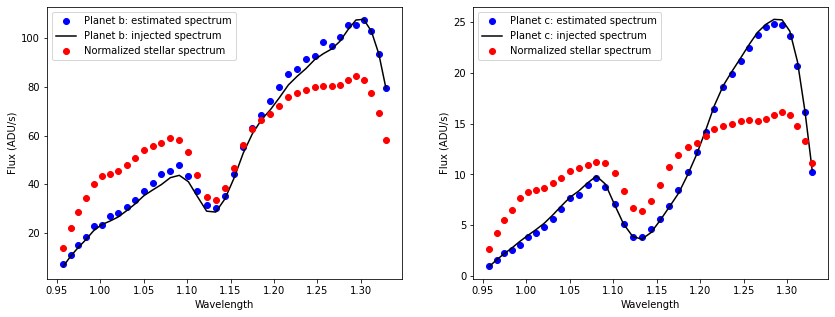

In [34]:
%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, est_fluxes1, 'bo', label='Planet b: estimated spectrum')
ax1.plot(lbda, gt_fluxes1, 'k', label='Planet b: injected spectrum')
ax1.plot(lbda, flux_st*(np.mean(est_fluxes1)/np.mean(flux_st)), 'ro', label='Normalized stellar spectrum')
ax1.set_xlabel("Wavelength")
ax1.set_ylabel("Flux (ADU/s)")
ax1.legend()

ax2.plot(lbda, est_fluxes2, 'bo', label='Planet c: estimated spectrum')
ax2.plot(lbda, gt_fluxes2, 'k', label='Planet c: injected spectrum')
ax2.plot(lbda, flux_st*(np.mean(est_fluxes2)/np.mean(flux_st)), 'ro', label='Normalized stellar spectrum')
ax2.set_xlabel("Wavelength")
ax2.set_ylabel("Flux (ADU/s)")
ax2.legend()
plt.show()

We see that the estimated spectrum is relatively close to the injected one, suggesting that the injection procedure was reliable. For comparison, we also show a normalized version of the stellar spectrum, which appears very different.

### 5.3. Renormalization of recovered spectrum to original units

Finally, let's compare the original planet spectra and the retrieved ones after atm.+instrumental transmission correction. For that, let's first resample the 

In [35]:
# resample original planet spectra
spec_b_res = resample_model(lbda, spec_b[0], spec_b[1], instru_res=spec_res)
spec_c_res = resample_model(lbda, spec_c[0], spec_c[1], instru_res=spec_res)

# resample star model spectrum
spec_star_mod_res = resample_model(spec_star[0], spec_star_mod[0], spec_star_mod[1], instru_res=spec_res)

# contrast
contrast1 = est_fluxes1/spec_star[1]
contrast2 = est_fluxes2/spec_star[1]

# conversion between input planet and star model spectra - including contrast
unit_conv1 = np.mean(spec_b_res[1]/(contrast1*spec_star_mod_res[1]))
unit_conv2 = np.mean(spec_c_res[1]/(contrast2*spec_star_mod_res[1]))
unit_conv1 = np.mean(spec_b_res[1])/np.mean(contrast1*spec_star_mod_res[1])
unit_conv2 = np.mean(spec_c_res[1])/np.mean(contrast2*spec_star_mod_res[1])

# final rescaled spectra (to original planet model spectra units)
resc_fluxes1 = contrast1*spec_star_mod_res[1]*unit_conv1
resc_fluxes2 = contrast2*spec_star_mod_res[1]*unit_conv2

In [36]:
# crop wavelength range of original spectrum

i0b = find_nearest(spec_b[0], lbda[0], constraint='floor')
iNb = find_nearest(spec_b[0], lbda[-1], constraint='floor')

i0c = find_nearest(spec_c[0], lbda[0], constraint='floor')
iNc = find_nearest(spec_c[0], lbda[-1], constraint='floor')

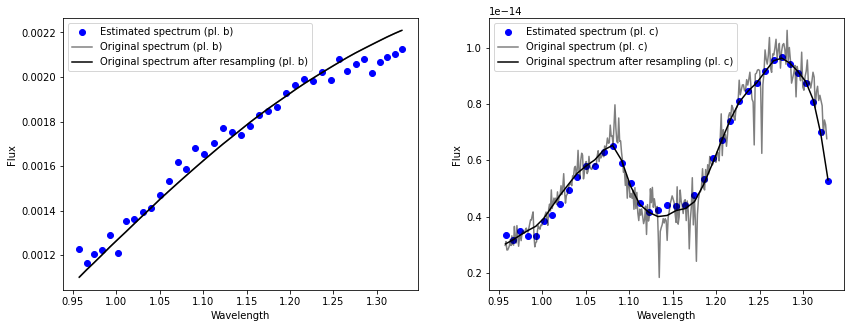

In [37]:
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, resc_fluxes1, 'bo', label='Estimated spectrum (pl. b)')
ax1.plot(spec_b[0,i0b:iNb], spec_b[1,i0b:iNb], 'k', alpha=0.5, label='Original spectrum (pl. b)')
ax1.plot(lbda, spec_b_res[1], 'k', label='Original spectrum after resampling (pl. b)')
ax1.set_xlabel("Wavelength")
ax1.set_ylabel("Flux")
ax1.legend()
ax2.plot(lbda, resc_fluxes2, 'bo', label='Estimated spectrum (pl. c)')
ax2.plot(spec_c[0,i0c:iNc], spec_c[1,i0c:iNc], 'k', alpha=0.5, label='Original spectrum (pl. c)')
ax2.plot(lbda, spec_c_res[1], 'k', label='Original spectrum after resampling (pl. c)')
ax2.set_xlabel("Wavelength")
ax2.set_ylabel("Flux")
ax2.legend()
plt.show()

Overall the original spectra appear relatively well recovered (modulo some possible biases due to the method used to retrieve the spectra).

[Go to the top](#Table-of-contents)